# Optimization for deep learning

In this Actvity, you will:

   * **Implement a number of deep learning optimization algorithms.** Implementing them is the best way to understand them thoroughly, and remember them. We will implement the optimization algorithms as custom PyTorch optimizers. Doing this has several benefits. First, you will be able to use them easily within your pyTorch code. Second, you will understand better the mechanics behind PyTorch optimizers. Third, it is useful to know how to code a custom PyTorch optimizer. You don't need to do it when you simply need built-in optimzers (we will do it for the sake of exercise), but you may need to do it if you want to do something more specific, implement a new optimization algorithm prensented in a paper, ...
   * **Visualize the loss lanscape for a very simple MLP, and compare the trajectory of various optimization methods on this lanscape**.

In this lab, we will use `Tensorboard`. Install this package if you don't have it.

In [1]:
%matplotlib inline
import math
import numpy as np
import torch
from torch import nn
import torch.optim as optim
from torch.optim import Optimizer
from torchvision import datasets, transforms
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from torch.utils.tensorboard import SummaryWriter
from sklearn.model_selection import StratifiedKFold
from torch.utils.data import Subset
from collections import Counter
from math import fabs

from torch.nn import Parameter
from torch.nn.functional import mse_loss
from torch.autograd import Variable
from torch.nn.functional import relu

from numpy.random import multivariate_normal
from scipy.linalg.special_matrices import toeplitz
from numpy.random import randn


## 1 - Implementing classical deep learning optimizers

A custom optimizer class in PyTorch has to inherit from `Optimizer`. This base class will notably provide 3 attributes to your custom optimizer:
 * `defaults`: a dict containing the default values for the optimization options (such as the learning rate for example).
 * `param_groups`: a list of dictionnaries, where each dictionnary has a key `params` mapping to a list of parameters to optimize, as well as keys mapping the name of optimization options to their values. In this lab, we will not use the functionalities provided by this attribute, so you can consider that it is a list of one dictionary, with a key `params` mapping to the list of all parameters your optimizer should optimize, as well as keys mapping the name of optimization options to their values.
 * `state`: this attribute is useful for *memory-based* optimizers (Adam is an example), which accumulate information from previous iterations.

1) **To clarify what these attributes are, instantiate a built-in SGD optimizer and print these attributes.** Note that since you need to pass parameters as arguments to any optimizer, you also need to instantiate a small model to do this.

In [2]:
model = nn.Sequential(
    nn.Linear(4, 2),
    nn.LogSoftmax(dim=1)
)
sgd = torch.optim.SGD(model.parameters(), lr=0.01)
print(sgd.defaults, '\n')
print(sgd.param_groups, '\n')
print(sgd.state)

{'lr': 0.01, 'momentum': 0, 'dampening': 0, 'weight_decay': 0, 'nesterov': False, 'maximize': False, 'foreach': None} 

[{'params': [Parameter containing:
tensor([[-0.0363, -0.4756, -0.2573,  0.0258],
        [ 0.2069,  0.4584,  0.0434, -0.0122]], requires_grad=True), Parameter containing:
tensor([-0.2176, -0.3894], requires_grad=True)], 'lr': 0.01, 'momentum': 0, 'dampening': 0, 'weight_decay': 0, 'nesterov': False, 'maximize': False, 'foreach': None}] 

defaultdict(<class 'dict'>, {})


There are two methods to implement for a custom optimizer:
 * `__init__(self, params, ...)`: it should take `params` as argument, where `params` is an iterable of the parameters to optimize. Then it should take as arguments the various hyperparamters that are required, such as for example the learning rate. This method should 1) do some checks on the validity of the hyperparameters (for example checking that the learning rate given is not negative), 2) create a `defaults` dictionary which maps the hyperparameters names to their values, 3) call the initializer of the `Optimizer` class using the `super` keyword (this is where the `defaults` dictionary is necessary).
 * `step(self, closure=None)`: this method does one optimization step. This is where the update rule of your optimization method is implemented. For the optimization algorithm we are going to implement, we will not need the `closure` argument, so you can just keep it equal to `None`. In order to update your parameters, you can access them using the `param_groups` attribute. Note that the gradients of the parameters are initially equal to `None`. They will however be defined as soon `backward()` is called for the first time on the loss.
 
You now have all the elements to start coding your own optimizer! To check wether your custom optimizers work well, you can use the code provided at the end of this section.

**1) Implement your custom optimzer for SGD**

In [3]:
class MySGD(Optimizer):
    def __init__(self, params, lr=0.01):
        if lr < 0:
            raise ValueError(f'The learning rate is negative: lr={lr}')
        
        defaults = {'lr': lr}
        
        super(MySGD, self).__init__(params, defaults)
        
    def step(self, closure=None):
        for group in self.param_groups:
            params = group['params']
            lr = group['lr']
            for p in params:
                if p.grad is None:
                    continue
                p.data = p.data - lr*p.grad

**2) Implement your custom optimizer for ADAM**

In [4]:
class MyAdam(Optimizer):
    def __init__(self, params, lr=0.01, beta1=0.9, beta2=0.999, eps=1e-8):
        if lr < 0:
            raise ValueError(f'The learning rate is negative: lr={lr}')
        if not 0 <= beta1 <= 1:
            raise ValueError(f'beta1 should be between 0 and 1: beta1={beta1}')
        if not 0 <= beta2 <= 1:
            raise ValueError(f'beta1 should be between 0 and 1: beta2={beta2}')
        if eps < 0:
            raise ValueError(f'eps is negative: esp={eps}')
            
        defaults = {'lr': lr, 'beta1': beta1, 'beta2': beta2, 'eps': eps}
        
        super(MyAdam, self).__init__(params, defaults)
        
    def step(self, closure=None):
        for group in self.param_groups:
            params = group['params']
            lr = group['lr']
            beta1 = group['beta1']
            beta2 = group['beta2']
            eps = group['eps']
            
            for p in params:
                param_state = self.state[p]
                
                if p.grad is None:
                    continue

                if 'exp_avg' not in param_state:
                    param_state['exp_avg'] = torch.zeros_like(p.grad)
                    param_state['exp_avg_sq'] = torch.zeros_like(p.grad)
                    param_state['step'] = 0

                param_state['step'] += 1

                exp_avg, exp_avg_sq = param_state['exp_avg'], param_state['exp_avg_sq']

                exp_avg.mul_(beta1).add_(p.grad, alpha=1 - beta1)
                exp_avg_sq.mul_(beta2).addcmul_(p.grad, p.grad, value=1 - beta2)

                bias_correction1 = 1-beta1**param_state['step']
                bias_correction2 = 1-beta2**param_state['step']

                denom = (exp_avg_sq.sqrt() / math.sqrt(bias_correction2)).add_(eps)
                num = exp_avg/bias_correction1

                p.data = p.data - lr*num/denom

In order to check the correctness of your built-in optimizers, you can use the following code:

In [5]:
# Simulate data
def simu_linreg(w0, n_samples=1000, corr=0.5, std=0.5):
    """Simulation of a linear regression model with Gaussian features
    and a Toeplitz covariance, with Gaussian noise.
    
    Parameters
    ----------
    w0 : `numpy.array`, shape=(n_features,)
        Model weights
    
    n_samples : `int`, default=1000
        Number of samples to simulate
    
    corr : `float`, default=0.5
        Correlation of the features
    
    std : `float`, default=0.5
        Standard deviation of the noise

    Returns
    -------
    X : `numpy.ndarray`, shape=(n_samples, n_features)
        Simulated features matrix. It contains samples of a centered 
        Gaussian  vector with Toeplitz covariance.
    
    y : `numpy.array`, shape=(n_samples,)
        Simulated labels
    """
    n_features = w0.shape[0]
    # Construction of a covariance matrix
    cov = toeplitz(corr ** np.arange(0, n_features))
    # Simulation of features
    X = multivariate_normal(np.zeros(n_features), cov, size=n_samples)
    # Simulation of the labels
    y = X.dot(w0) + std * randn(n_samples)
    return X, y

w0 = np.arange(4)
X, y = simu_linreg(w0)
n, p = X.shape

# Instantiate a loss, model, and your choice of optimizer
criterion = nn.MSELoss()

torch.manual_seed(0)
model = nn.Sequential(
    nn.Linear(4, 1)
)

optimizer = MySGD(model.parameters(), lr=0.01)

# Train the model
n_epochs = 2
for e in range(n_epochs):
    running_loss = 0
    for xb, yb in zip(X, y):
        xb = xb.reshape((1, p))
        xb = torch.from_numpy(xb).float()
        yb = torch.Tensor([[yb]]).float()

        # Training pass
        optimizer.zero_grad()
        pred = model(xb)
        loss = criterion(pred, yb)
        loss.backward()
        optimizer.step()

        # Store the running loss
        running_loss += loss.item()
        
    print(f'epoch {e}, running loss={round(running_loss/n, 3)}')
    
print(optimizer.param_groups[0]['params'])

epoch 0, running loss=0.745
epoch 1, running loss=0.26
[Parameter containing:
tensor([[-0.0217,  1.0203,  1.9934,  2.9105]], requires_grad=True), Parameter containing:
tensor([-0.0464], requires_grad=True)]


## 2 - Optimization landscape of a minimal MLP

We will now try to better understand how stochastic gradient works. We will fit a very simple MLP to data generated from a linear ground truth model, and observe how the (stochastic) loss landscape changes when selecting different samples.

Data is generated from a simple model:
$$y=  2x + \epsilon$$

where:

- $\epsilon \sim \mathcal{N}(0, 3)$ (here 3 would be the standard deviation)
- $x \sim \mathcal{U}(-1, 1)$

**1) Write a function `sample_from_ground_truth` which takes as argument `n_samples` and which returns the data `x` and `y` generated as described above.** Return `x`and `y`as tensors of shape `[n_samples, 1]`.

In [6]:
torch.manual_seed(0)
def sample_from_ground_truth(n_samples=100, std=0.1):
    x = torch.FloatTensor(n_samples, 1).uniform_(-1, 1)
    epsilon = torch.FloatTensor(n_samples, 1).normal_(0, std)
    y = 2 * x + epsilon
    return x, y

n_samples = 100
std = 3
x, y = sample_from_ground_truth(n_samples, std)
print(x.shape)
print(y.shape)
print(x.mean(),y.mean())
print(x.std(),y.std())

torch.Size([100, 1])
torch.Size([100, 1])
tensor(-0.0232) tensor(-0.0547)
tensor(0.5890) tensor(2.7422)


We propose a minimal single hidden layer MLP model with a single hidden unit and no bias. The model has two tunable parameters $w_1$, and $w_2$, such that:

$$f(x) = w_1 \cdot \sigma(w_2 \cdot x)$$

where $\sigma$ is the ReLU function.

**2) Implement a class `SimpleMLP` that represents this model.** It should inherit from `nn.Module` and have methods `__init__`and `forward`. Write your class in such a way that you can instantiate your model with a chosen initialisation for your weights, that would be passed as argument to the `__init__` method. If you need more hints on how to implement your own model in PyTorch without using built-in modules, you can look at the correction of the bonus question 1 from the previous lab.

In [7]:
class SimpleMLP(nn.Module):

    def __init__(self, w=None):
        super(SimpleMLP, self).__init__()
        self.w1 = Parameter(torch.FloatTensor((1,)))
        self.w2 = Parameter(torch.FloatTensor((1,)))
        if w is None:
            self.reset_parameters()
        else:
            self.set_parameters(w)

    def reset_parameters(self):
        self.w1.uniform_(-.1, .1)
        self.w2.uniform_(-.1, .1)

    def set_parameters(self, w):
        with torch.no_grad():
            self.w1[0] = w[0]
            self.w2[0] = w[1]

    def forward(self, x):
        return self.w1 * relu(self.w2 * x)   

We will now define a function to sample from and plot loss landscapes.

The function `make_grids` creates a `[grid_size, grid_size, 2]` tensor that holds the coordinates of each point of the grid.

In [8]:
def make_grids(x, y, grid_size=100):
    n_samples = len(x)
    assert len(x) == len(y)

    # Grid logic
    x_max, y_max, x_min, y_min = 5, 5, -5, -5
    w1 = np.linspace(x_min, x_max, grid_size, dtype=np.float32)
    w2 = np.linspace(y_min, y_max, grid_size, dtype=np.float32)
    W1, W2 = np.meshgrid(w1, w2)

    return W1, W2

W1, W2 = make_grids(x, y)
print(W1.shape)
print(W1[0:3, 0:3])
print(W2[0:3, 0:3])

(100, 100)
[[-5.        -4.8989897 -4.79798  ]
 [-5.        -4.8989897 -4.79798  ]
 [-5.        -4.8989897 -4.79798  ]]
[[-5.        -5.        -5.       ]
 [-4.8989897 -4.8989897 -4.8989897]
 [-4.79798   -4.79798   -4.79798  ]]


We will now compute the expected risk, the empirical risk, and the risk assciated to one single sample, for each coordinate of the grid. For a point with indices `[i, j]` on the grid, the risk associated to one single sample $(x_k, y_k)$ is defined as:
$$\ell(f(w_1^{(i)} , w_2^{(j)}, x_k), y_k)$$
and the empirical risk is defined as:
$$ \frac{1}{n} \sum_{k=1}^{n} \ell(f(w_1^{(i)}, w_2^{(j)}, x_k), y_k)$$

You will use `mse_loss` as loss function.

**3) Derive the formula of the expected risk as a function of the parameters $w_1$ and $w_2$.**

We now create a function `expected_risk_simple_mlp` that takes as arguments `w1`and `w2` and returns the expected risk.

In [9]:
def expected_risk_simple_mlp(w1, w2):
    return .5 * (8 / 3 - (4 / 3) * w1 * w2 + 1 / 3 * w1 ** 2 * w2 ** 2) + std ** 2

**4) Compute the expected risk, the empirical risk, as well as the risk associated to one single sample for each coordinate of the grid.** To do this, create a function `compute_risks` that will return in this order:
 * `W1`: the first output of `make_grids`.
 * `W2`: the second output of `make_grids`.
 * `risks`: a numpy array of size `[n_samples, grid_size, grid_size]` that contains the risk associated to one sample for each sample and each point of the grid.
 * `empirical_risk`: a numpy array  of size `[grid_size, grid_size]`.
 * `expected_risk`: a numpy array  of size `[grid_size, grid_size]`.

In [10]:
def compute_risks(x, y, model_constructor, expected_risk_func, grid_size=100):
    
    W1, W2 = make_grids(x, y)
    W = np.concatenate((W1[:, :, None], W2[:, :, None]), axis=2)
    W = torch.from_numpy(W)
    
    # We will store the results in these tensors
    risks = torch.FloatTensor(n_samples, grid_size, grid_size)
    expected_risk = torch.FloatTensor(grid_size, grid_size)
    
    with torch.no_grad():
        for i in range(grid_size):
            for j in range(grid_size):
                model = model_constructor(W[i, j])
                pred = model(x)
                loss = mse_loss(pred, y, reduce=False)
                risks[:, i, j] = loss.view(-1)
                expected_risk[i, j] = expected_risk_func(W[i, j, 0], W[i, j, 1])
        empirical_risk = torch.mean(risks, dim=0)
        
    return W1, W2, risks.numpy(), empirical_risk.numpy(), expected_risk.numpy()

In [11]:
W1, W2, risks, empirical_risk, expected_risk = compute_risks(
    x, y, SimpleMLP, expected_risk_func=expected_risk_simple_mlp)

C:\Users\lupin\anaconda3\lib\site-packages\torch\nn\_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='none' instead.
  warnings.warn(warning.format(ret))


We will now train our simple model with various optimizers. The goal is then to plot the optimization trajectories for the various optimizers over the loss landscape.

**5) Define a train loop and train our `SimpleMLP`**. You should iterate over the dataset one sample at a time (batch size of 1). For this, you will define a `train` function that takes as inputs:
 * `model`: an instance of `SimpleMLP`.
 * `optimizer`: an instance of an optimizer.
 * `x`: the data
 * `y`: the data
 * `n_epochs`: the numbr of epochs
 
 This function should return:
 * a numpy array where each row has two columns and corresponds to an iterate of the parameters `w1` and `w2` (one iterate per optimization step)
 * another numpy array that stores similarly the gradients of `w1` and `w2` after each step.

In [12]:
def train(model, optimizer, x, y, n_epochs=1):
    iterate_rec = []
    grad_rec = []
    for epoch in range(n_epochs):
        # Iterate over the dataset one sample at a time:
        # batch_size=1
        for this_x, this_y in zip(x, y):
            this_x = this_x[None, :]
            this_y = this_y[None, :]
            optimizer.zero_grad()
            pred = model(this_x)
            loss = mse_loss(pred, this_y)
            loss.backward()
            with torch.no_grad():
                iterate_rec.append([model.w1.clone()[0], model.w2.clone()[0]])
                grad_rec.append([model.w1.grad.clone()[0], model.w2.grad.clone()[0]])
            optimizer.step()
    return np.array(iterate_rec), np.array(grad_rec)

In [13]:
optimizers = ['rmsprop', 'sgd', 'adam', 'adagrad']
iterates = []
grads = []

# Define an initialization
init = torch.FloatTensor([3, -4])

# Choose a number of epochs
n_epochs=4

for name in optimizers:
    model = SimpleMLP(init)
    
    if name == 'sgd':
        optimizer = optim.SGD(model.parameters(), lr=0.01)
    elif name == 'adam':
        optimizer = optim.Adam(model.parameters(), lr=0.1)
    elif name == 'adagrad':
        optimizer = optim.Adagrad(model.parameters(), lr=0.1)
    elif name == 'rmsprop':
        optimizer = optim.RMSprop(model.parameters(), lr=0.1)
        
    iterate, grad = train(model, optimizer, x, y, n_epochs=n_epochs)
    
    iterates.append(iterate)
    grads.append(grad)

In [14]:
for iterate in iterates:
    print(iterate[-1])

[-0.4614291 -0.7765492]
[-0.30054212 -2.3582213 ]
[-0.2724562 -1.3188533]
[ 1.4765915 -2.5521262]


We now plot:
- the risk associated to one single sample at iteration $k$ on the left plot
- the total empirical risk on the center plot
- the expected risk on the right plot

Observe how empirical and expected risk differ, and how empirical risk minimization is not totally equivalent to expected risk minimization.

On these loss landscape, we also plot the optimization trajectories of the different optimizers.

In [15]:
class LevelsNormalize(colors.Normalize):
    def __init__(self, levels, clip=False):
        self.levels = levels
        vmin, vmax = levels[0], levels[-1]
        colors.Normalize.__init__(self, vmin, vmax, clip)

    def __call__(self, value, clip=None):
        quantiles = np.linspace(0, 1, len(self.levels))
        return np.ma.masked_array(np.interp(value, self.levels, quantiles))


def plot_map(W1, W2, risks, emp_risk, exp_risk, sample, iter_, iterates, grads, cols, optimizers):
    all_risks = np.concatenate((emp_risk.ravel(), exp_risk.ravel()))
    x_center, y_center = emp_risk.shape[0] // 2, emp_risk.shape[1] // 2
    risk_at_center = exp_risk[x_center, y_center]
    low_levels = np.percentile(all_risks[all_risks <= risk_at_center],
                               q=np.linspace(0, 100, 11))
    high_levels = np.percentile(all_risks[all_risks > risk_at_center],
                                q=np.linspace(10, 100, 10))
    levels = np.concatenate((low_levels, high_levels))
    norm = LevelsNormalize(levels=levels)

    cmap = plt.get_cmap('RdBu_r')
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(12, 4))
    risk_levels = levels.copy()
    risk_levels[0] = min(risks[sample].min(), risk_levels[0])
    risk_levels[-1] = max(risks[sample].max(), risk_levels[-1])
    
    ax1.contourf(W1, W2, risks[sample], levels=risk_levels,
                 norm=norm, cmap=cmap)
    for iterate, color in zip(iterates, cols):
        ax1.scatter(iterate[iter_, 0], iterate[iter_, 1],
                    color=color)
    for iterate, grad, color in zip(iterates, grads, cols):
        if any(grad[iter_] != 0):
            ax1.arrow(iterate[iter_, 0], iterate[iter_, 1],
                      -0.1 * grad[iter_, 0], -0.1 * grad[iter_, 1],
                      head_width=0.3, head_length=0.5, fc=color, ec=color)
    ax1.set_title('Pointwise risk')
    
    
    ax2.contourf(W1, W2, emp_risk, levels=levels, norm=norm, cmap=cmap)
    for iterate, color, name in zip(iterates, cols, optimizers):
        ax2.plot(iterate[:iter_ + 1, 0], iterate[:iter_ + 1, 1],
                 linestyle='-', marker='o', markersize=0,
                 color=color, linewidth=2, label=f'{name} trajectory')
    ax2.legend()
    ax2.set_title('Empirical risk')
    
    
    cf = ax3.contourf(W1, W2, exp_risk, levels=levels, norm=norm, cmap=cmap)
    for iterate, color, name in zip(iterates, cols, optimizers):
        ax3.plot(iterate[:iter_ + 1, 0], iterate[:iter_ + 1, 1],
                 linestyle='-', marker='o', markersize=0,
                 color=color, linewidth=2, label=f'{name} trajectory')
    ax3.set_title('Expected risk (ground truth)')
    plt.colorbar(cf, ax=ax3)
    # ax3.legend()
    fig.suptitle('Iter %i, sample % i' % (iter_, sample))
    plt.show()

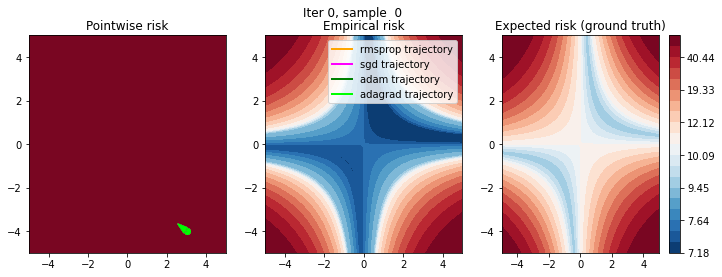

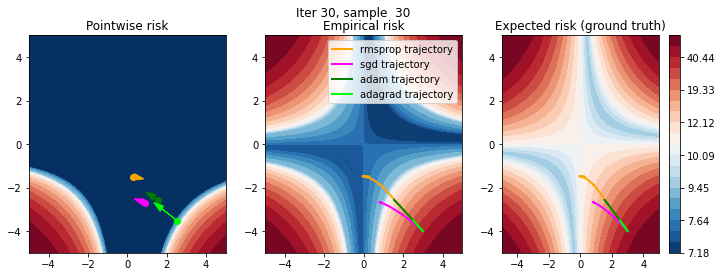

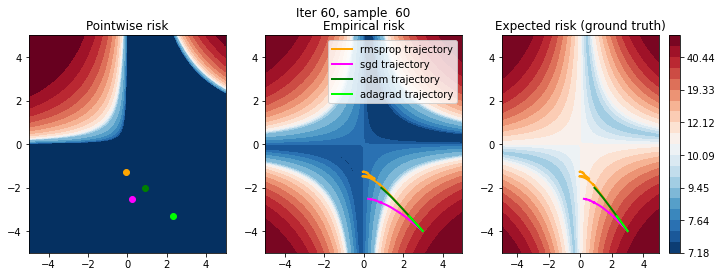

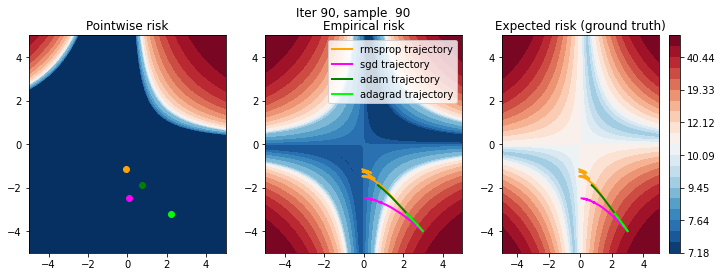

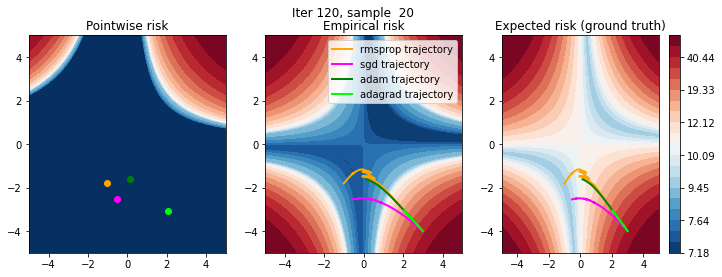

...

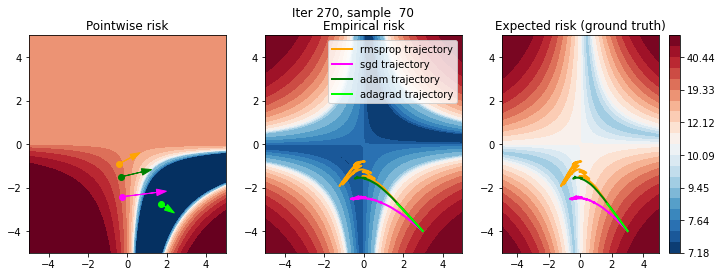

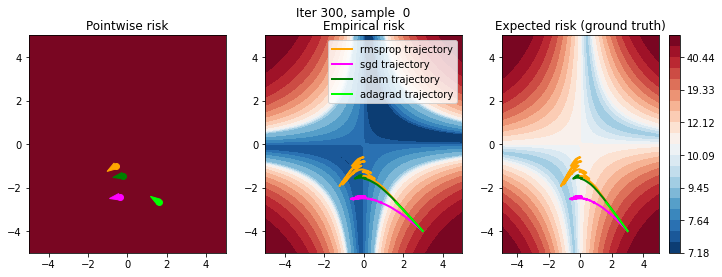

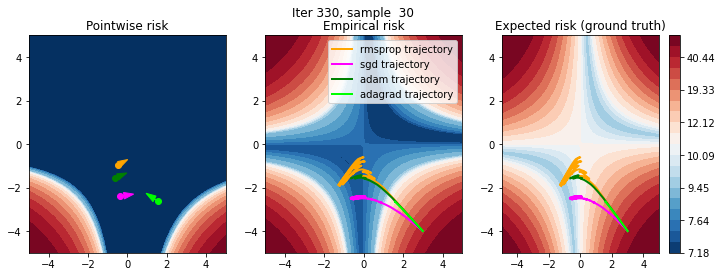

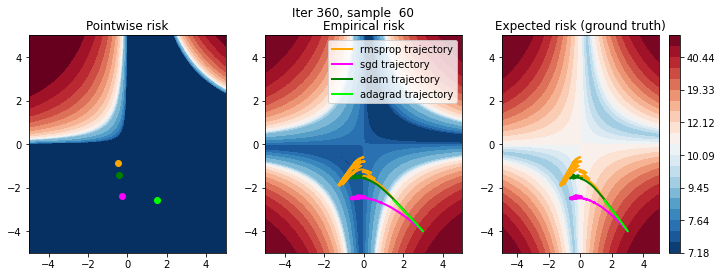

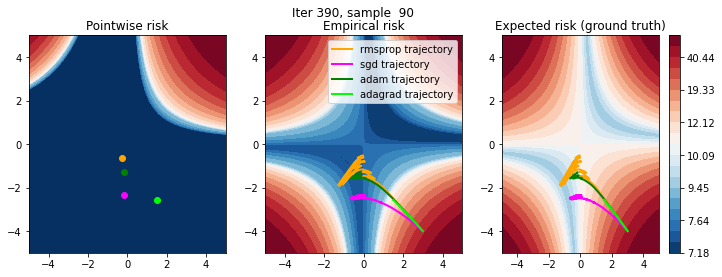

In [16]:
cols = ['orange', 'magenta', 'green', 'lime', 'dodgerblue']
for it in range(0, n_samples*n_epochs, 30):
   plot_map(W1, W2, risks, empirical_risk, expected_risk, it%n_samples, it, iterates, grads, cols, optimizers)

Observe and comment.

### Bonus exercices:

- Try to initialize the model with pathological weights, e.g., symmetric ones. What do you observe?
- You may increase the number of epochs to observe slow convergence phenomena
- Try augmenting the noise in the dataset. What do you observe?
- Try changing the random seed that fixed data generation.

You may be surprised by the fact that Adam is slower than SGD methods. To see why, you may want to have a look at section 2.1 of [this paper](https://arxiv.org/pdf/1412.6980.pdf%20%22%20entire%20document).

The code below allows you to produce a video.

In [17]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(10, 10))
all_risks = np.concatenate((empirical_risk.ravel(),
                            expected_risk.ravel()))

x_center, y_center = empirical_risk.shape[0] // 2, empirical_risk.shape[1] // 2
risk_at_center = expected_risk[x_center, y_center]
low_levels = np.percentile(all_risks[all_risks <= risk_at_center],
                           q=np.linspace(0, 100, 11))
high_levels = np.percentile(all_risks[all_risks > risk_at_center],
                            q=np.linspace(10, 100, 10))
levels = np.concatenate((low_levels, high_levels))
norm = LevelsNormalize(levels=levels)

cmap = plt.get_cmap('RdBu_r')
ax.set_title('Expected risk')
lines = [ax.plot([], [], label=f'{name}', color=color)[0]
         for name, color in zip(optimizers, cols)]
ax.legend()


def animate(i):
    for c in ax.collections:
        c.remove()
    for l in ax.lines:
        l.remove()
    for p in ax.patches:
        p.remove()
        
    ax.contourf(W1, W2, expected_risk, levels=levels, norm=norm, cmap=cmap)

    c = 0
    for iterate, color, name in zip(iterates, cols, optimizers):
        c += 1
        ax.plot(iterate[:i + 1, 0], iterate[:i + 1, 1],
                 linestyle='-', marker='', markersize=6,
                 color=color, linewidth=1, label=f'{name} trajectory', zorder=c)
        ax.scatter(iterate[i, 0], iterate[i, 1], marker='o',
                   color=color, zorder=c)

    return []

anim = FuncAnimation(fig, animate,# init_func=init,
                     frames=n_epochs*n_samples, interval=50, blit=False)
anim.save("stochastic_landscape_minimal_mlp.mp4")
plt.close(fig)
# HTML(anim.to_html5_video())
HTML(anim.to_jshtml())